In [18]:
# Librerias
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

%matplotlib inline
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split, KFold, cross_validate, cross_val_predict, cross_val_score, StratifiedKFold, RepeatedStratifiedKFold


In [19]:
# plot histogramas
def plot_histograms(dataframe):
    columns = dataframe.columns
    num_cols = len(columns)
    num_rows = (num_cols // 2) + (num_cols % 4 > 0)

    fig, axes = plt.subplots(num_rows, 2, figsize=(12, 4 * num_rows))
    fig.tight_layout(pad=3.0)
    plt.subplots_adjust(hspace=0.3) 
    axes = axes.flatten()
   
    for i, column in enumerate(columns):
        ax = axes[i]
        sns.histplot(dataframe[column], ax=ax)
        ax.set_title(f'Histogram of {column}')

        # Calculate the value counts for each category in the column
        value_counts = dataframe[column].value_counts()
        total_count = len(dataframe[column])
        
        # Sort and select the top 5 values
        top_5 = value_counts.head(5)

        # Annotate the top 5 bars with their percentage
        for val, count in top_5.items():
            percentage = (count / total_count) * 100
            ax.annotate(f'{percentage:.1f}%', 
                        xy=(val, count), 
                        xytext=(0, 2),  # Offset text slightly above the bar
                        textcoords='offset points', 
                        ha='center', 
                        color='black')

    for i in range(num_cols, num_rows * 2):
        fig.delaxes(axes[i])       
    plt.show()
    
def describe_categorical_variables(data):
    categorical_cols = data.select_dtypes(include=['object']).columns
    categorical_stats = pd.DataFrame(index=categorical_cols, columns=['Unique Values', 'Count', 'Top_Frequency', 'Top'])
    for col in categorical_cols:
        unique_values = data[col].unique()
        unique_count = len(unique_values)
        top_value = data[col].mode().iloc[0]
        top_freq = data[col].value_counts().iloc[0]/len(data)
        categorical_stats.loc[col] = [unique_values, unique_count, top_freq, top_value]
    return categorical_stats

In [20]:
def plot_top10(dataframe):
    columns = dataframe.columns
    num_cols = len(columns)
    num_rows = (num_cols // 2) + (num_cols % 2 > 0)

    fig, axes = plt.subplots(num_rows, 2, figsize=(12, 4 * num_rows))
    fig.tight_layout(pad=3.0)
    plt.subplots_adjust(hspace=0.3) 
    axes = axes.flatten()
   
    for i, column in enumerate(columns):
        ax = axes[i]

        # Calculate the value counts for each category in the column and select the top 10
        value_counts = dataframe[column].value_counts().head(10)
        top_10_categories = value_counts.index

        # Filter the dataframe to include only the top 10 categories
        filtered_data = dataframe[column][dataframe[column].isin(top_10_categories)]

        # Plot the filtered data with the counts for each of the top 10 categories
        sns.histplot(filtered_data, ax=ax, discrete=True)

        # Set the title with the column name
        ax.set_title(f'Histogram of {column} (Top 10 Categories)')

        # Rotate x-axis labels for better readability
        ax.tick_params(axis='x', rotation=45)

        # Annotate the top 10 bars with their percentage
        total_count = len(dataframe[column])
        for val, count in value_counts.items():
            percentage = (count / total_count) * 100
            ax.annotate(f'{percentage:.1f}%', 
                        xy=(val, count), 
                        xytext=(0, 2),  # Offset text slightly above the bar
                        textcoords='offset points', 
                        ha='center', 
                        color='black')

    # Remove any extra axes if there are more subplots than columns
    for i in range(num_cols, num_rows * 2):
        fig.delaxes(axes[i])       
    plt.show()

In [21]:

def plot_boxplots_vscat(dataframe, target_continuous):
    # Select categorical columns
    cat_columns = dataframe.select_dtypes(include=['object', 'category']).columns
    num_cols = len(cat_columns)
    num_rows = (num_cols // 2) + (num_cols % 2 > 0)

    # Create subplots
    fig, axes = plt.subplots(num_rows, 2, figsize=(20, 4 * num_rows))
    fig.tight_layout(pad=3.0)
    plt.subplots_adjust(hspace=0.3)  
    axes = axes.flatten()

    # Iterate through each categorical column and plot it against the target continuous variable
    for i, column in enumerate(cat_columns):
        ax = axes[i]
        sns.boxplot(x=dataframe[column], y=dataframe[target_continuous], ax=ax)
        ax.set_title(f'Boxplot of {target_continuous} vs {column}')
        ax.set_xlabel(column)
        ax.set_ylabel(target_continuous)
        ax.tick_params(axis='x', rotation=45)  # Rotate x-axis labels for better readability

    # Remove any extra subplots if there are more subplots than columns
    for i in range(num_cols, num_rows * 2):
        fig.delaxes(axes[i])

    plt.show()

In [22]:
def plot_hist(variable):
    plt.figure(figsize=(12, 5))
    plt.tight_layout()
    ax = sns.histplot(x=variable, discrete=True)
    
    # Calculate the total count for percentages
    total_count = len(variable)
    
    # Annotate each bar with its count and percentage
    for p in ax.patches:
        count = int(p.get_height())
        percentage = (count / total_count) * 100
        ax.annotate(f'{count} ({percentage:.1f}%)',  # Display count and percentage
                    (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha='center', va='center', xytext=(0, 10), textcoords='offset points')
    
    # Set x-ticks to unique values to avoid additional ticks
    unique_vals = sorted(variable.unique())
    ax.set_xticks(unique_vals)
    ax.set_xticklabels(unique_vals, rotation=30, horizontalalignment='right')
    
    plt.show()

In [23]:
import ipywidgets as widgets
from IPython.display import display

def dropdown_features(df, default=None):
    feature_names = list(df.columns)
    
    # Set the default value to the provided default or the first column if none is specified
    default_value = default if default in feature_names else feature_names[0]
    
    # Create a dropdown widget
    ft_dropdown = widgets.Dropdown(
        options=feature_names,
        value=default_value,  
        description='Variable:',
        disabled=False,
    )
    
    def on_dropdown_change(change):
        global selection
        selection = df[change.new]    
        
    # Attach the function to the dropdown's change event
    ft_dropdown.observe(on_dropdown_change, names='value')
    
    # Display the dropdown
    display(ft_dropdown)

### Diccionario de Datos
- **work_year**: The year the salary was paid.
- **experience_level**: The experience level in the job during the year with the following possible values:
    - **EN**: Entry-level / Junior
    - **MI**: Mid-level / Intermediate
    - **SE**: Senior-level / Expert
    - **EX**: Executive-level / Director
- **employment_type**: The type of employment for the role:
    - **PT**: Part-time
    - **FT**: Full-time
    - **CT**: Contract
    - **FL**: Freelance
- **job_title**: The role worked in during the year.
- **salary**: The total gross salary amount paid.
- **salary_currency**: The currency of the salary paid as an ISO 4217 currency code.
- **salary_in_usd**: The salary in USD (FX rate divided by avg. USD rate of respective year) via statistical data from the BIS and central banks.
- **employee_residence**: Employee's primary country of residence during the work year as an ISO 3166 country code.
- **remote_ratio**:
  - **description**: The overall amount of work done remotely, possible values are as follows:
    - **0**: No remote work (less than 20%)
    - **50**: Partially remote/hybrid
    - **100**: Fully remote (more than 80%)
- **company_location**: The country of the employer's main office or contracting branch as an ISO 3166 country code.
- **company_size**: The average number of people that worked for the company during the year:
    - **S**: less than 50 employees (small)
    - **M**: 50 to 250 employees (medium)
    - **L**: more than 250 employees (large)

### 1. Carga de los datos


In [24]:
data_raw = pd.read_csv('Data/salaries.csv')
data_raw.head(3)

,work_year,experience_level,employment_type,job_title,salary,salary_currency,salary_in_usd,employee_residence,remote_ratio,company_location,company_size
0,2024,MI,FT,Associate,167500,USD,167500,US,0,US,M
1,2024,MI,FT,Associate,106500,USD,106500,US,0,US,M
2,2024,SE,FT,Data Engineer,183300,USD,183300,US,0,US,M


In [25]:
from ydata_profiling import ProfileReport
#profile151024 = ProfileReport(data_raw, title="Reporte Datos Salarios", explorative=True)

# display report 
#profile.to_notebook_iframe()

# Export  report to  HTML 
#profile151024.to_file("data_salarios_report151024.html")

#### 2. Exploración y Perfilamiento de Datos

##### Separación Muestra de Evaluación
Siguiendo el ciclo de machine learning, antes de explorar los datos se separa una parte del conjunto de datos (85%) que nos servirá para evaluar los modelos construidos. Random State = 77

In [26]:
# test sample
data, eva = train_test_split(data_raw, test_size=0.15, random_state=77)
data.head(3)

,work_year,experience_level,employment_type,job_title,salary,salary_currency,salary_in_usd,employee_residence,remote_ratio,company_location,company_size
53287,2022,SE,FT,Data Engineer,130000,USD,130000,US,100,US,M
29733,2024,MI,FT,Data Scientist,111740,USD,111740,US,0,US,M
23692,2024,SE,FT,Data Scientist,115000,USD,115000,US,100,US,M


In [27]:
data_exc_salary = data.loc[:, ~data.columns.isin(['salary', 'salary_in_usd'])]

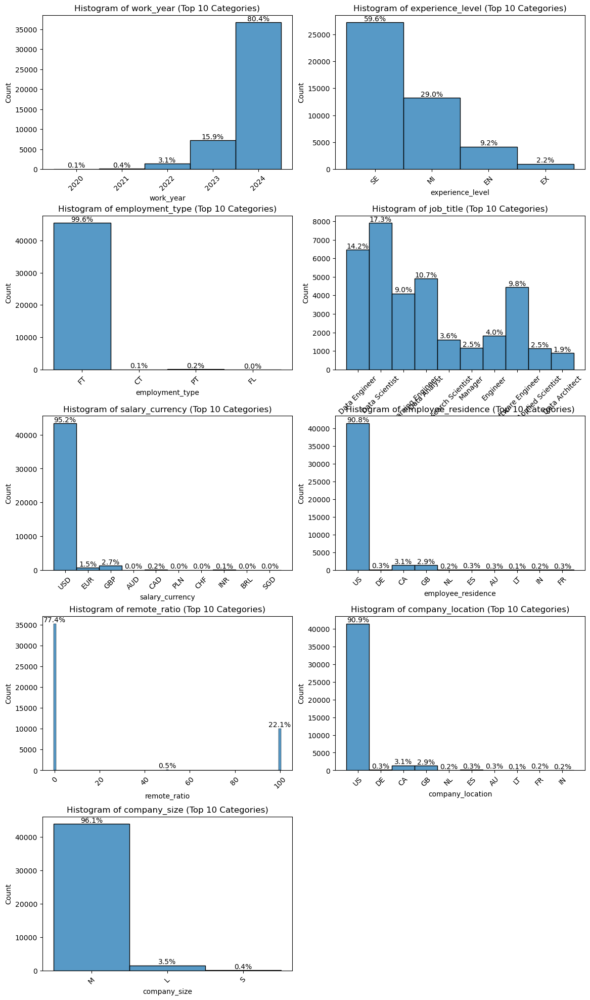

In [28]:
plot_top10(data_exc_salary)

In [29]:
top_10_jobs = data['job_title'].value_counts().head(10)
top_10_jobs

job_title
Data Scientist               7915
Data Engineer                6466
Data Analyst                 4900
Software Engineer            4450
Machine Learning Engineer    4102
Engineer                     1831
Research Scientist           1621
Manager                      1161
Applied Scientist            1140
Data Architect                886
Name: count, dtype: int64

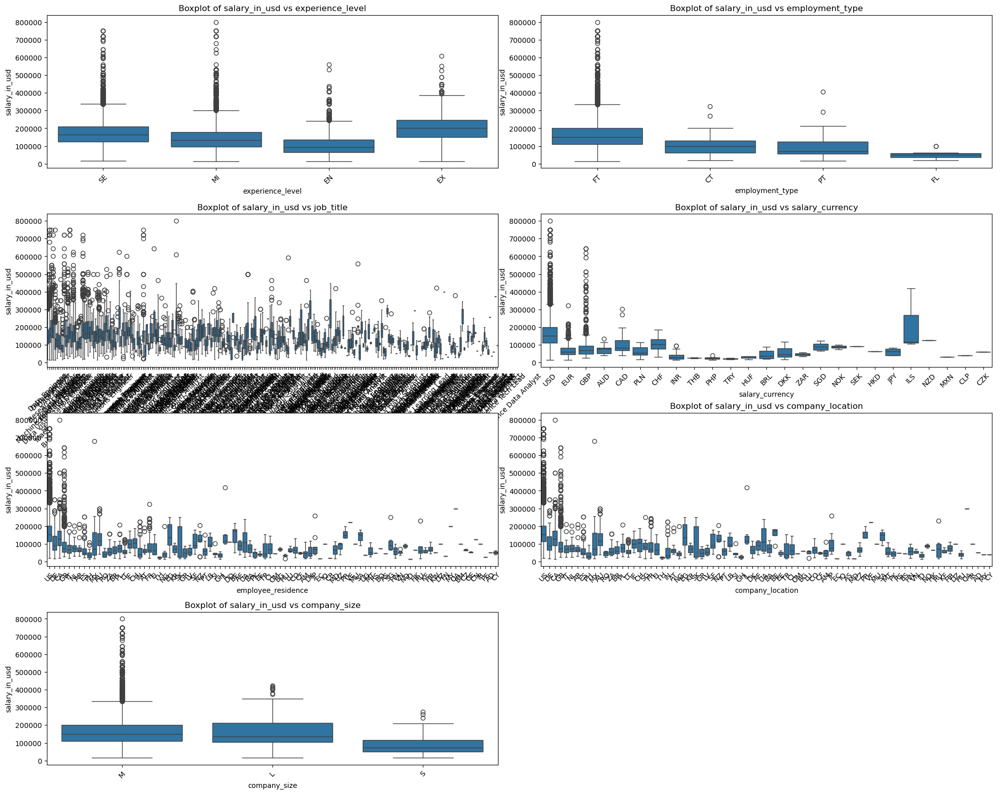

In [30]:
plot_boxplots_vscat(data,"salary_in_usd")

In [31]:
# dropdown_features(data)

In [32]:
#plot_hist(selection)

#### 3. Limpieza de los Datos

In [33]:
#!pip install -q pycountry-convert

In [34]:
# Función para agrupar company_location y employee_residency
import pycountry_convert as pc
def get_continent(col):
    try:
        if len(col) == 2:
            country_code = col
        else:
            country_code = pc.country_name_to_country_alpha2(col.strip('\'"'))
        continent_name = pc.convert_continent_code_to_continent_name(pc.country_alpha2_to_continent_code(country_code))
        return continent_name
    except:
        return None


In [35]:
# 1. Eliminación duplicados
data = data.drop_duplicates() 
# 2. Filtrar año 2024
data = data.loc[data["work_year"] == 2024] 
 # 3. descartar columnas innecesarias
columns_to_drop = ['work_year', 'salary', 'salary_currency']
data = data.drop(columns=columns_to_drop)
# 4. Correccion employment_type = FL cambiarlo por FT
data['employment_type'] = data['employment_type'].replace('FL', 'FT')
# 5. Agrupar company_location y employee_residency en continentes
data['company_location']=data['company_location'].apply(lambda x: get_continent(x))
data['employee_residence']=data['employee_residence'].apply(lambda x: get_continent(x))
data.shape

(17879, 8)

In [36]:
# 6. filtrar los datos para 10 posiciones mas populares
top_10_titles = data['job_title'].value_counts().nlargest(10).index
data_top10 = data[data['job_title'].isin(top_10_titles)]
data_top10.shape

(11409, 8)

In [37]:
# Función tratamiento de valores anómalos
def remove_outliers(df, column_name, threshold=1.5):
    Q1 = df[column_name].quantile(0.25)
    Q3 = df[column_name].quantile(0.75)
    
    IQR = Q3 - Q1
    
    lower_bound = Q1 - threshold * IQR
    upper_bound = Q3 + threshold * IQR
    
    filtered_df = df[(df[column_name] >= lower_bound) & (df[column_name] <= upper_bound)]
    
    return filtered_df

In [38]:
# Tratamiento de valores anómalos
data_top10 = remove_outliers(data_top10, 'salary_in_usd')
data_top10.shape

(11193, 8)

In [39]:
# Cross-tabulation between company_location and employee_residence
location_comparison = pd.crosstab(data['company_location'], data['employee_residence'])
location_comparison

employee_residence,Africa,Asia,Europe,North America,Oceania,South America
company_location,,,,,,
Africa,47,0,0,1,0,0
Asia,0,90,0,0,0,0
Europe,0,0,1070,1,0,0
North America,0,1,0,16513,0,0
Oceania,0,0,0,0,107,0
South America,0,0,0,0,0,49


In [40]:
different_locations = data_top10[data_top10['company_location'] != data_top10['employee_residence']]
print(f"Número de ubicaciones diferentes: {len(different_locations)}")

Número de ubicaciones diferentes: 1


In [41]:
location_comparison_top10 = pd.crosstab(data_top10['company_location'], data_top10['employee_residence'])
location_comparison_top10

employee_residence,Africa,Asia,Europe,North America,Oceania,South America
company_location,,,,,,
Africa,31,0,0,0,0,0
Asia,0,55,0,0,0,0
Europe,0,0,699,1,0,0
North America,0,0,0,10296,0,0
Oceania,0,0,0,0,73,0
South America,0,0,0,0,0,38


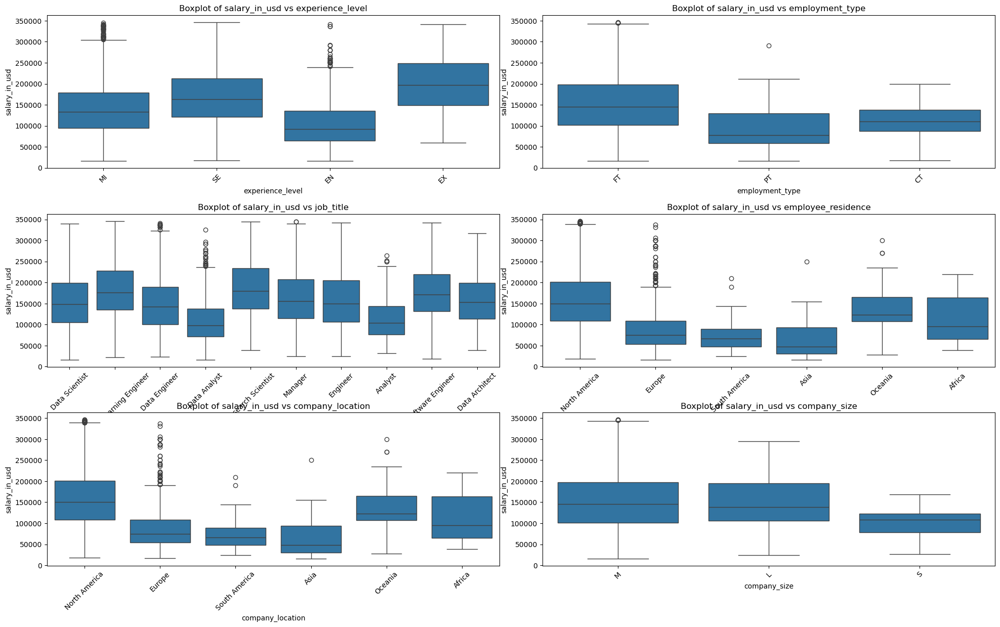

In [42]:
plot_boxplots_vscat(data_top10,"salary_in_usd")

In [43]:
# Saving to CSV
#data_top10.to_csv('data_top10.csv', index=False)

#### 4. Alternativas para el manejo del problema de regresión como clasificacion:

In [44]:
def tablas_contingencia(dataframe, target):
    tablas_contingencia = {}
    for column in dataframe.columns:
        if column != target and dataframe[column].dtype == 'object':
            # Create a contingency table using pd.crosstab()
            tabla = pd.crosstab(dataframe[column], dataframe[target])
            # Store the table in the dictionary with the column name as the key
            tablas_contingencia[column] = tabla
    return tablas_contingencia

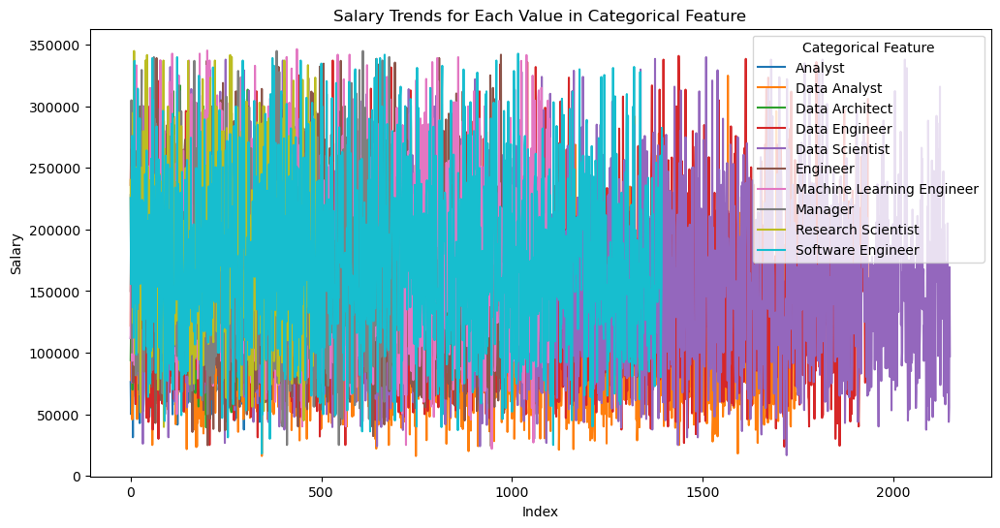

In [45]:
# Sort or group data by the categorical feature
grouped = data_top10.groupby('job_title')['salary_in_usd'].apply(list)

# Plot each category as a line
plt.figure(figsize=(12, 6))
for category, salaries in grouped.items():
    plt.plot(salaries, label=category)  # Each category as a separate line

plt.title('Salary Trends for Each Value in Categorical Feature')
plt.xlabel('Index')
plt.ylabel('Salary')
plt.legend(title='Categorical Feature')
plt.show()

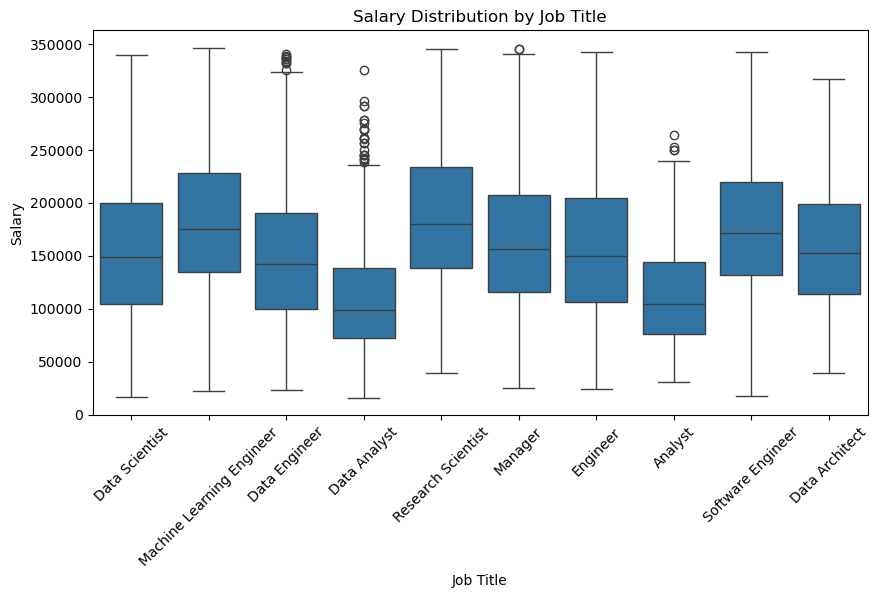

In [46]:
# Boxplot job_tilte vs. Salary
plt.figure(figsize=(10, 5))
sns.boxplot(data=data_top10, x='job_title', y='salary_in_usd')
plt.title('Salary Distribution by Job Title')
plt.xlabel('Job Title')
plt.ylabel('Salary')
plt.xticks(rotation=45)  
plt.show()

In [47]:
data_top10.describe()

,salary_in_usd,remote_ratio
count,11193.000000,11193.000000
mean,153545.911373,21.857411
std,66652.954537,41.300002
min,16000.000000,0.000000
25%,101520.000000,0.000000
50%,145000.000000,0.000000
75%,198000.000000,0.000000
max,346500.000000,100.000000


In [48]:
# Calculate the lower and upper quartiles for each job title
quartiles = data_top10.groupby('job_title')['salary_in_usd'].quantile([0.25, 0.75]).unstack()
quartiles.columns = ['Lower Quartile (Q1)', 'Upper Quartile (Q3)']
quartiles

,Lower Quartile (Q1),Upper Quartile (Q3)
job_title,,
Analyst,76437.5,144012.5
Data Analyst,71958.0,138000.0
Data Architect,113762.5,199325.0
Data Engineer,100052.5,190000.0
Data Scientist,104922.0,199700.0
Engineer,106080.0,205000.0
Machine Learning Engineer,135000.0,227800.0
Manager,115450.0,207250.0
Research Scientist,138000.0,234000.0


#### 4.1 Opcion 1: Clases = Rangos de salarios

In [49]:
# función para clasificar rangos de salarios
def classify_salary(salary):
    if salary < 75000:
        return 'Bajo'
    elif 75000 <= salary < 120000:
        return 'Medio_Bajo'
    elif 120000 <= salary < 180000:
        return 'Medio_Alto'
    else:
        return 'Alto'

In [50]:
# Mapeo Opcion 1 salary_class
data_top10['salary_class'] = data_top10['salary_in_usd'].apply(classify_salary)
data_top10.head(3)

,experience_level,employment_type,job_title,salary_in_usd,employee_residence,remote_ratio,company_location,company_size,salary_class
29733,MI,FT,Data Scientist,111740,North America,0,North America,M,Medio_Bajo
23692,SE,FT,Data Scientist,115000,North America,100,North America,M,Medio_Bajo
39047,SE,FT,Machine Learning Engineer,112000,North America,0,North America,M,Medio_Bajo


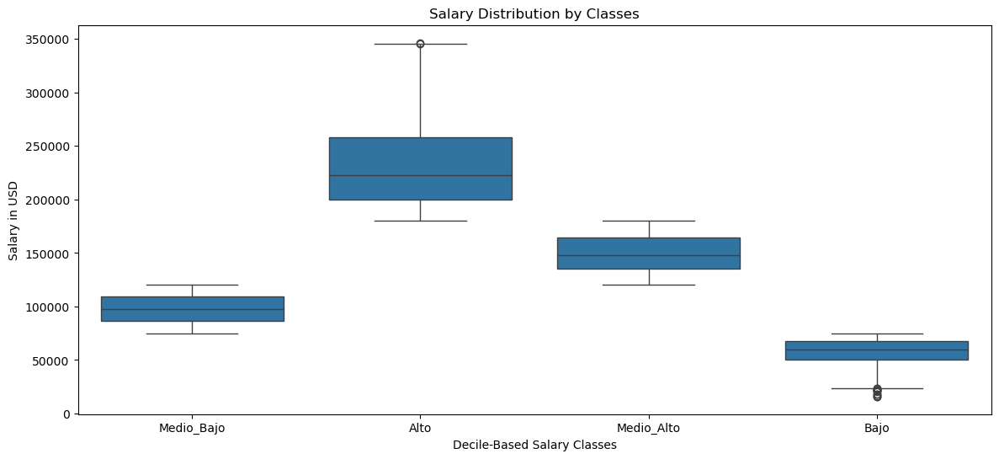

In [51]:
plt.figure(figsize=(14, 6))
sns.boxplot(data=data_top10, x='salary_class', y='salary_in_usd')
plt.title('Salary Distribution by Classes')
plt.xlabel('Decile-Based Salary Classes')
plt.ylabel('Salary in USD')
plt.show()

#### 4.2 Opcion 2: Clases = Deciles

In [52]:
# función para mapear salarios en deciles
deciles = data_top10['salary_in_usd'].quantile([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

# Step 2: Define function to classify based on deciles
def classify_salary_deciles(salary):
    if salary <= deciles[0.1]:
        return 'D1'
    elif deciles[0.1] < salary <= deciles[0.2]:
        return 'D2'
    elif deciles[0.2] < salary <= deciles[0.3]:
        return 'D3'
    elif deciles[0.3] < salary <= deciles[0.4]:
        return 'D4'
    elif deciles[0.4] < salary <= deciles[0.5]:
        return 'D5'
    elif deciles[0.5] < salary <= deciles[0.6]:
        return 'D6'
    elif deciles[0.6] < salary <= deciles[0.7]:
        return 'D7'
    elif deciles[0.7] < salary <= deciles[0.8]:
        return 'D8'
    elif deciles[0.8] < salary <= deciles[0.9]:
        return 'D9'
    else:
        return 'D10'

In [53]:
# Mapear 
data_top10['salary_deciles'] = data_top10['salary_in_usd'].apply(classify_salary_deciles)
data_top10.head(3)

,experience_level,employment_type,job_title,salary_in_usd,employee_residence,remote_ratio,company_location,company_size,salary_class,salary_deciles
29733,MI,FT,Data Scientist,111740,North America,0,North America,M,Medio_Bajo,D4
23692,SE,FT,Data Scientist,115000,North America,100,North America,M,Medio_Bajo,D4
39047,SE,FT,Machine Learning Engineer,112000,North America,0,North America,M,Medio_Bajo,D4


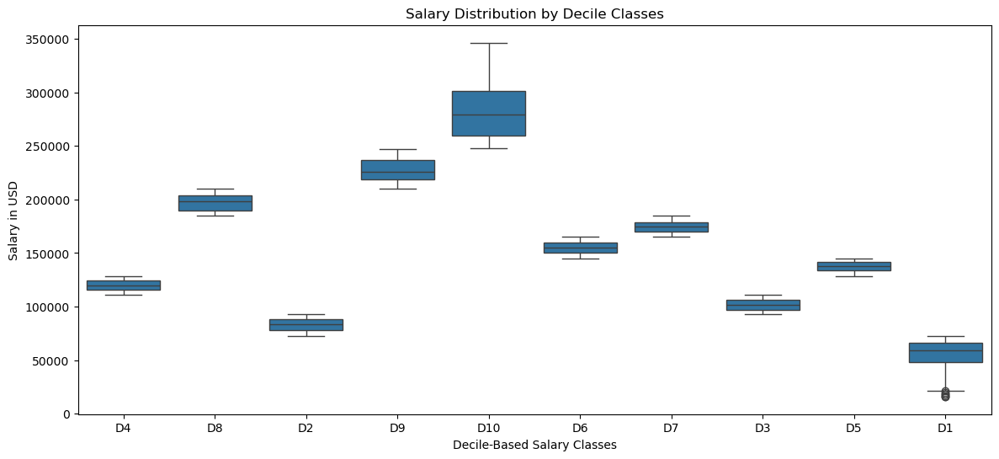

In [54]:
plt.figure(figsize=(14, 6))
sns.boxplot(data=data_top10, x='salary_deciles', y='salary_in_usd')
plt.title('Salary Distribution by Decile Classes')
plt.xlabel('Decile-Based Salary Classes')
plt.ylabel('Salary in USD')
plt.show()

#### Tablas de Contingencia

In [55]:
tablas_con_sal_class = tablas_contingencia(data_top10, 'salary_class')
tablas_con_sal_dec = tablas_contingencia(data_top10, 'salary_deciles')

In [56]:
# Tabla Contigencia job_title vs. salary_class
cont_job_title_cls = tablas_con_sal_class['job_title']
cont_job_title_cls

salary_class,Alto,Bajo,Medio_Alto,Medio_Bajo
job_title,,,,
Analyst,37,76,98,129
Data Analyst,152,477,464,652
Data Architect,114,15,132,91
Data Engineer,574,209,658,493
Data Scientist,696,201,735,517
Engineer,349,92,311,229
Machine Learning Engineer,532,36,379,154
Manager,261,37,247,159
Research Scientist,251,13,161,68


In [57]:

# Tabla Contigencia job_title vs. salary_deciles
cont_job_title_dec = tablas_con_sal_dec['job_title']
cont_job_title_dec

salary_deciles,D1,D10,D2,D3,D4,D5,D6,D7,D8,D9
job_title,,,,,,,,,,
Analyst,72,4,67,51,35,34,33,18,20,6
Data Analyst,449,16,339,248,180,158,143,100,62,50
Data Architect,14,38,29,40,43,33,42,44,34,35
Data Engineer,188,140,206,212,205,196,191,203,207,186
Data Scientist,190,209,192,228,218,205,237,217,224,229
Engineer,84,124,96,87,110,94,83,105,98,100
Machine Learning Engineer,29,196,43,64,103,126,114,115,147,164
Manager,36,98,56,70,75,76,77,65,81,70
Research Scientist,9,90,22,27,40,50,37,71,67,80


#### 5.  Separación Entrenamiento y Prueba

In [58]:
data_top10.columns

Index(['experience_level', 'employment_type', 'job_title', 'salary_in_usd',
       'employee_residence', 'remote_ratio', 'company_location',
       'company_size', 'salary_class', 'salary_deciles'],
      dtype='object')

In [59]:
# Eliminación columnas redundantes
columns_to_drop = ['salary_in_usd', 'salary_class']
data_top10 = data_top10.drop(columns_to_drop,axis = 1)
data_top10.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11193 entries, 29733 to 41132
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   experience_level    11193 non-null  object
 1   employment_type     11193 non-null  object
 2   job_title           11193 non-null  object
 3   employee_residence  11193 non-null  object
 4   remote_ratio        11193 non-null  int64 
 5   company_location    11193 non-null  object
 6   company_size        11193 non-null  object
 7   salary_deciles      11193 non-null  object
dtypes: int64(1), object(7)
memory usage: 787.0+ KB


In [60]:
data_top10.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11193 entries, 29733 to 41132
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   experience_level    11193 non-null  object
 1   employment_type     11193 non-null  object
 2   job_title           11193 non-null  object
 3   employee_residence  11193 non-null  object
 4   remote_ratio        11193 non-null  int64 
 5   company_location    11193 non-null  object
 6   company_size        11193 non-null  object
 7   salary_deciles      11193 non-null  object
dtypes: int64(1), object(7)
memory usage: 787.0+ KB


In [61]:
# Treat 'remote_ratio' as a categorical feature by converting it to 'object' type
data_top10['remote_ratio'] = data_top10['remote_ratio'].astype(str)

In [62]:
# test sample
y = data_top10['salary_deciles']
X = data_top10.drop('salary_deciles', axis=1)

In [63]:
# Encode the target variable
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)  # Convert D1-D9 to numeric labels

In [64]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=77)

#### 6. Modelos

In [65]:
#pip install catboost


In [66]:
#pip install XGBoost

In [67]:
from sklearn.preprocessing import OneHotEncoder
from xgboost import XGBClassifier
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report
from scipy.stats import uniform, randint
from random import random, seed
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split, KFold, cross_validate, cross_val_predict, cross_val_score, StratifiedKFold, RepeatedStratifiedKFold
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, recall_score, average_precision_score, f1_score, classification_report, precision_recall_curve, auc
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression

import xgboost as xgb
from xgboost.sklearn import XGBClassifier
from xgboost import plot_importance

import time
import warnings 
#warnings.filterwarnings("ignore")


In [68]:
# Funcion Random_Search
kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=52)

def random_search(pipeline, param_grid, X_train, y_train, cv=kfold, n_iter=30, scoring="accuracy"): 
    random_search = RandomizedSearchCV(
        estimator=pipeline,
        param_distributions=param_grid,
        n_iter=n_iter,
        cv=cv,
        verbose=1,
        random_state=42,
        n_jobs=-1,
        scoring=scoring
    )
    
    start_time = time.time()
    random_search.fit(X_train, y_train)
    end_time = time.time()
    elapsed_time = (end_time - start_time) / 60  # Time in minutes
    
    return random_search, elapsed_time

In [69]:
# Identify categorical columns
categorical_cols = X.select_dtypes(include=['object']).columns

# Set up OneHotEncoder for categorical features
column_transformer = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first'), categorical_cols)
    ],
    remainder='passthrough'
)

##### XGBoost

In [72]:
# Initialize the XGBoost model
xgb_model = XGBClassifier(objective="multi:softmax", num_class=10, eval_metric="mlogloss")

# Create a pipeline with preprocessing and model
pipeline_xgb = Pipeline(steps=[
    ('preprocessor', column_transformer),
    ('classifier', xgb_model)
])

# Define parameter grid for random search
param_grid_xgb = {
    'classifier__n_estimators': randint(10, 201),
    'classifier__max_depth': randint(3, 11),
    'classifier__learning_rate':  uniform(0.01, 0.29),
    'classifier__reg_lambda': uniform(0, 1)
}

In [73]:
# Fit the RandomizedSearchCV
rs_xgb, elapsed_time_xgb = random_search(pipeline_xgb, param_grid_xgb, X_train, y_train)

Fitting 5 folds for each of 30 candidates, totalling 150 fits


In [75]:
print(f"Tiempo de entrenamiento {elapsed_time_xgb:.2f} minutos")

Tiempo de entrenamiento 0.33 minutos


In [77]:
# Best parameters and score
best_params_xgb = rs_xgb.best_params_
best_score_xgb = rs_xgb.best_score_

print(f"Best Parameters XGB: {best_params_xgb}")
print(f"Best Cross-Validation Score XGB: {best_score_xgb:.4f}")

# Test score 
test_acc_xgb = rs_xgb.score(X_test, y_test)
print(f"Test Accuracy XGB): {test_acc_xgb:.4f}")

Best Parameters XGB: {'classifier__learning_rate': 0.140340695500079, 'classifier__max_depth': 3, 'classifier__n_estimators': 57, 'classifier__reg_lambda': 0.37081825219826636}
Best Cross-Validation Score XGB: 0.1890
Test Accuracy XGB): 0.1880


In [78]:
best_xgb_model = rs_xgb.best_estimator_

# Evaluate the best model on the test set
y_pred = best_xgb_model.predict(X_test)

# Print the classification report
print(classification_report(y_test, y_pred, target_names=label_encoder.classes_))

              precision    recall  f1-score   support

          D1       0.37      0.59      0.45       216
         D10       0.18      0.60      0.27       222
          D2       0.14      0.28      0.19       228
          D3       0.16      0.11      0.13       219
          D4       0.20      0.00      0.01       240
          D5       0.12      0.02      0.04       235
          D6       0.17      0.10      0.12       221
          D7       0.13      0.07      0.09       214
          D8       0.09      0.06      0.07       213
          D9       0.14      0.09      0.11       231

    accuracy                           0.19      2239
   macro avg       0.17      0.19      0.15      2239
weighted avg       0.17      0.19      0.15      2239



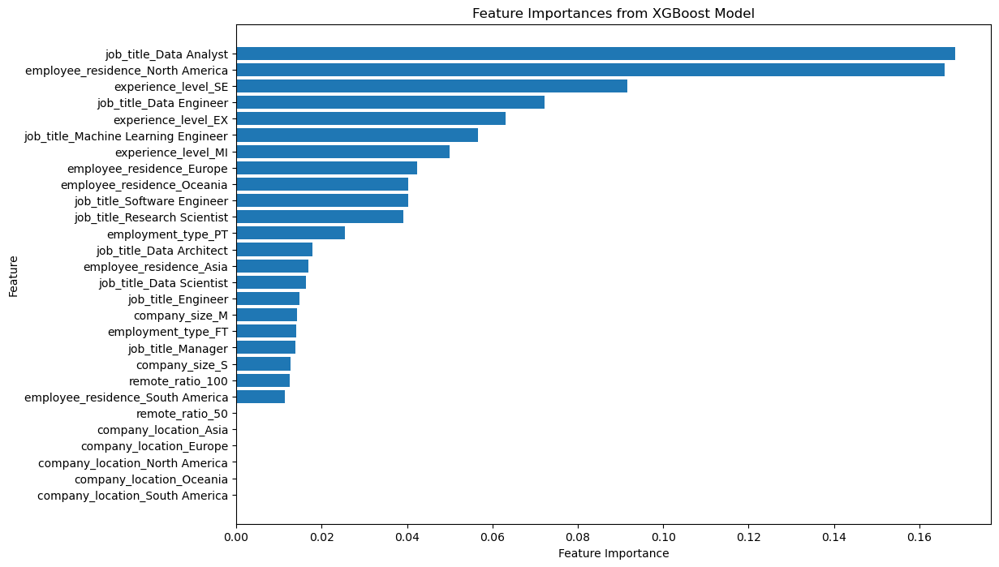

In [86]:
# Extract feature importances
feature_imp_xgb = best_xgb_model.named_steps['classifier'].feature_importances_

# Access the OneHotEncoder within the pipeline's preprocessor
onehot_encoder = best_xgb_model.named_steps['preprocessor'].transformers_[0][1]
feature_names = onehot_encoder.get_feature_names_out(input_features=categorical_cols)

# Create a DataFrame to hold feature names and their importances
imp_xgb_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_imp_xgb})

# Sort by importance for better readability in the plot
imp_xgb_df = imp_xgb_df.sort_values(by='Importance', ascending=False)

# Plot the feature importances
plt.figure(figsize=(12, 8))
plt.barh(imp_xgb_df['Feature'], imp_xgb_df['Importance'])
plt.xlabel("Feature Importance")
plt.ylabel("Feature")
plt.title("Feature Importances from XGBoost Model")
plt.gca().invert_yaxis()
plt.show()

##### RandomForest

In [90]:
# Initialize the RandomForest model
rf_model = RandomForestClassifier(random_state=42)

# Create a pipeline with preprocessing and model
pipeline_rf = Pipeline(steps=[
    ('preprocessor', column_transformer),
    ('classifier', rf_model)
])

# Define parameter grid for random search
param_grid_rf = {
    'classifier__n_estimators': randint(50, 500),
    'classifier__max_depth': randint(5, 21),
    'classifier__min_samples_split': randint(2, 10),
    'classifier__min_samples_leaf': randint(1, 5),
    'classifier__max_features': ['sqrt', 'log2', None],
    'classifier__bootstrap': [True, False]
}

In [91]:
# Fit the RandomizedSearchCV
rs_rf, elapsed_time_rf = random_search(pipeline_rf, param_grid_rf, X_train, y_train)
print(f"Tiempo de entrenamiento {elapsed_time_rf:.2f} minutos")

Fitting 5 folds for each of 30 candidates, totalling 150 fits
Tiempo de entrenamiento 0.50 minutos


In [92]:
# Best parameters and score
best_params_rf = rs_rf.best_params_
best_score_rf = rs_rf.best_score_

print(f"Best Parameters RandomForest: {best_params_rf}")
print(f"Best Cross-Validation Score RandomForest: {best_score_rf:.4f}")

# Test score 
test_acc_rf = rs_rf.score(X_test, y_test)
print(f"Test Accuracy RandomForest): {test_acc_rf:.4f}")
best_rf_model = rs_rf.best_estimator_


Best Parameters RandomForest: {'classifier__bootstrap': True, 'classifier__max_depth': 6, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 9, 'classifier__n_estimators': 459}
Best Cross-Validation Score RandomForest: 0.1884
Test Accuracy RandomForest): 0.1965


In [93]:

# Evaluate the best model on the test set
y_pred_rf = best_rf_model.predict(X_test)

# Print the classification report
print(classification_report(y_test, y_pred_rf, target_names=label_encoder.classes_))


              precision    recall  f1-score   support

          D1       0.35      0.69      0.46       216
         D10       0.18      0.59      0.27       222
          D2       0.19      0.07      0.11       228
          D3       0.14      0.29      0.19       219
          D4       0.24      0.05      0.09       240
          D5       0.16      0.04      0.06       235
          D6       0.00      0.00      0.00       221
          D7       0.12      0.06      0.08       214
          D8       0.17      0.04      0.06       213
          D9       0.14      0.15      0.14       231

    accuracy                           0.20      2239
   macro avg       0.17      0.20      0.15      2239
weighted avg       0.17      0.20      0.15      2239



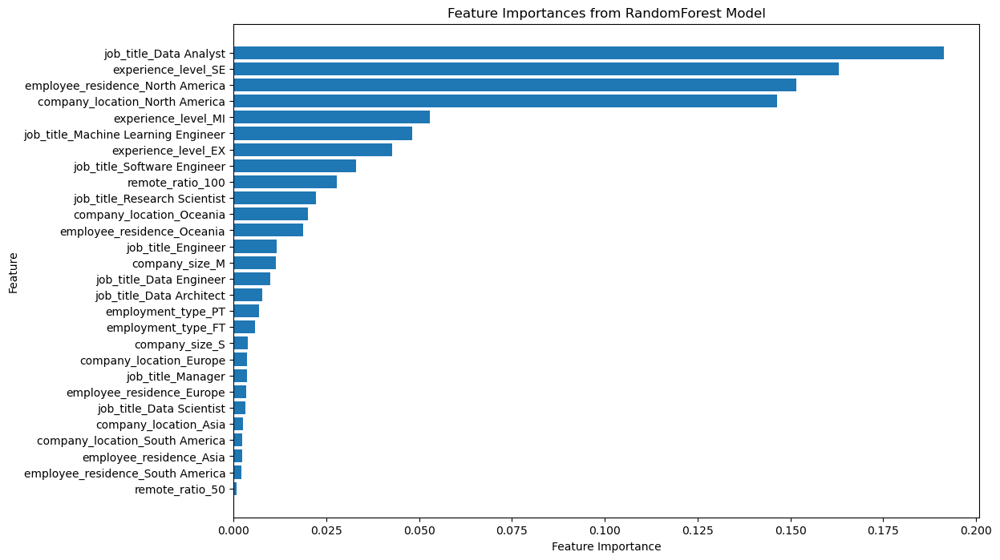

In [94]:

# Extract feature importances
feature_imp_rf = best_rf_model.named_steps['classifier'].feature_importances_

# Access the OneHotEncoder within the pipeline's preprocessor
onehot_encoder = best_rf_model.named_steps['preprocessor'].transformers_[0][1]
feature_names = onehot_encoder.get_feature_names_out(input_features=categorical_cols)

# Create a DataFrame to hold feature names and their importances
imp_rf_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_imp_rf})

# Sort by importance for better readability in the plot
imp_rf_df = imp_rf_df.sort_values(by='Importance', ascending=False)

# Plot the feature importances
plt.figure(figsize=(12, 8))
plt.barh(imp_rf_df['Feature'], imp_rf_df['Importance'])
plt.xlabel("Feature Importance")
plt.ylabel("Feature")
plt.title("Feature Importances from RandomForest Model")
plt.gca().invert_yaxis()
plt.show()

##### LGBoost

In [77]:
# Convert all features to 'category' dtype
X_train_cat = X_train.apply(lambda x: x.astype('category'))
X_test_cat = X_test.apply(lambda x: x.astype('category'))

# Convert categories to integer codes
X_train_cat = X_train_cat.apply(lambda x: x.cat.codes)
X_test_cat = X_test_cat.apply(lambda x: x.cat.codes)

In [70]:
from lightgbm import LGBMClassifier

# Initialize the LGBMClassifier for multiclass classification
lgbm_model = LGBMClassifier(objective="multiclass", random_state=42)

In [75]:
# Define parameter grid for random search
param_grid_lgbm = {
    'n_estimators': randint(50, 300),
    'max_depth': randint(5, 20),
    'learning_rate': uniform(0.01, 0.3),
    'num_leaves': randint(20, 150),
    'feature_fraction': uniform(0.7, 0.3),
    'bagging_fraction': uniform(0.7, 0.3)
}


In [78]:
# Perform the random search on LightGBM
rs_lgbm, elapsed_time_lgbm = random_search(lgbm_model, param_grid_lgbm, X_train_cat, y_train)
print(f"Tiempo de entrenamiento {elapsed_time_lgbm:.2f} minutos")

Fitting 5 folds for each of 30 candidates, totalling 150 fits
[LightGBM] [Warning] feature_fraction is set=0.9852142919229747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9852142919229747
[LightGBM] [Warning] bagging_fraction is set=0.8123620356542087, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8123620356542087
[LightGBM] [Warning] feature_fraction is set=0.9852142919229747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9852142919229747
[LightGBM] [Warning] bagging_fraction is set=0.8123620356542087, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8123620356542087
[LightGBM] [Warning] feature_fraction is set=0.9852142919229747, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9852142919229747
[LightGBM] [Warning] bagging_fraction is set=0.8123620356542087, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8123620356542087
[LightGBM] [Warning] feature_fracti

In [79]:
# Best parameters and score
best_params_lgbm = rs_lgbm.best_params_
best_score_lgbm = rs_lgbm.best_score_

print(f"Best Parameters LGBM: {best_params_lgbm}")
print(f"Best Cross-Validation Score LGBM: {best_score_lgbm:.4f}")

# Test score 
test_acc_lgbm = rs_lgbm.score(X_test_cat, y_test)
print(f"Test Accuracy LGBM): {test_acc_lgbm:.4f}")
best_lgbm_model = rs_lgbm.best_estimator_

Best Parameters LGBM: {'bagging_fraction': 0.9316734307889971, 'feature_fraction': 0.7596147044602517, 'learning_rate': 0.01165663513708072, 'max_depth': 15, 'n_estimators': 292, 'num_leaves': 100}
Best Cross-Validation Score LGBM: 0.1806
[LightGBM] [Warning] feature_fraction is set=0.7596147044602517, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7596147044602517
[LightGBM] [Warning] bagging_fraction is set=0.9316734307889971, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9316734307889971
Test Accuracy LGBM): 0.1979


In [80]:
# Evaluate the best model on the test set
y_pred_lgbm = best_lgbm_model.predict(X_test_cat)

# Print the classification report
print(classification_report(y_test, y_pred_lgbm, target_names=label_encoder.classes_))

[LightGBM] [Warning] feature_fraction is set=0.7596147044602517, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7596147044602517
[LightGBM] [Warning] bagging_fraction is set=0.9316734307889971, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9316734307889971
              precision    recall  f1-score   support

          D1       0.36      0.63      0.46       216
         D10       0.18      0.55      0.27       222
          D2       0.16      0.31      0.21       228
          D3       0.18      0.08      0.11       219
          D4       0.23      0.03      0.05       240
          D5       0.13      0.08      0.10       235
          D6       0.15      0.05      0.08       221
          D7       0.11      0.06      0.07       214
          D8       0.16      0.17      0.17       213
          D9       0.21      0.05      0.08       231

    accuracy                           0.20      2239
   macro avg       0.19      0.20      0.16      

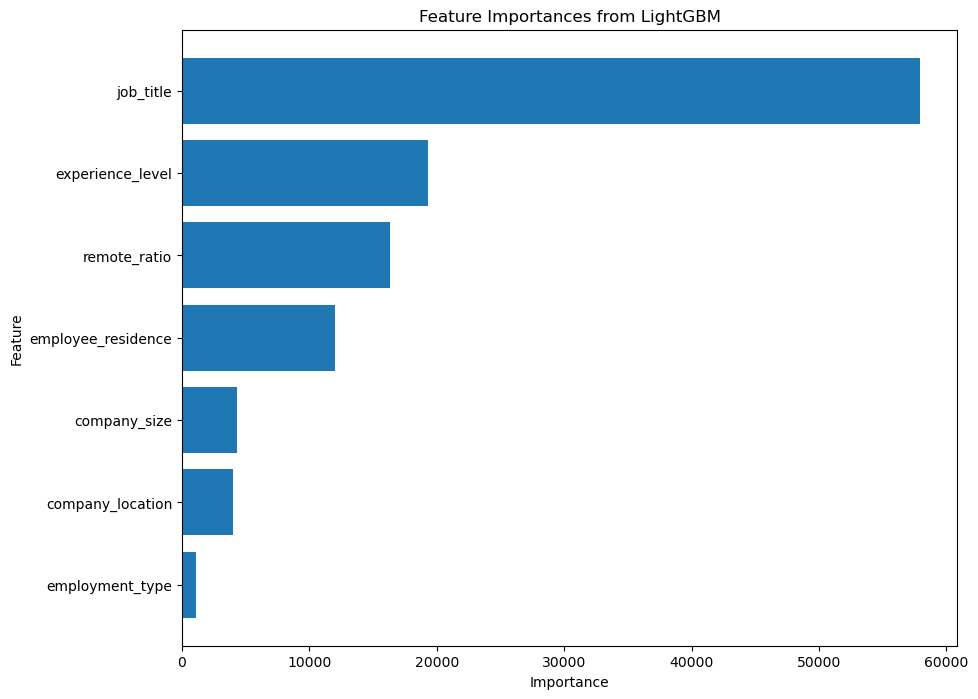

In [81]:
# Feature importances
feature_importances = best_lgbm_model.feature_importances_
feature_names = X_train.columns  # Original feature names

# Combine into a DataFrame 
importances_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances})
importances_df = importances_df.sort_values(by='Importance', ascending=False)

# Plot 
plt.figure(figsize=(10, 8))
plt.barh(importances_df['Feature'], importances_df['Importance'])
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.title("Feature Importances from LightGBM")
plt.gca().invert_yaxis()  
plt.show()

##### CatBoost

In [84]:
from catboost import CatBoostClassifier

# Initialize CatBoost model with multiclass objective
catboost_model = CatBoostClassifier(
    iterations=500,
    random_state=42,
    verbose=0,  # Suppress output for brevity
    loss_function='MultiClass'
)

# Parameter grid for CatBoost
param_grid_catboost = {
    'iterations': randint(100, 600),
    'depth': randint(4, 10),
    'learning_rate': uniform(0.01, 0.3),
    'l2_leaf_reg': uniform(1, 10)
}


In [85]:
# Run RandomizedSearchCV on CatBoost
rs_cb, elapsed_time_cb = random_search(catboost_model, param_grid_catboost, X_train_cat, y_train)
print(f"Tiempo de entrenamiento {elapsed_time_cb:.2f} minutos")

Fitting 5 folds for each of 30 candidates, totalling 150 fits
Tiempo de entrenamiento 1.42 minutos


In [86]:
# Best parameters and score
best_params_cb = rs_cb.best_params_
best_score_cb = rs_cb.best_score_

print(f"Best Parameters CatBoost: {best_params_cb}")
print(f"Best Cross-Validation Score CatBoost: {best_score_cb:.4f}")

# Test score 
test_acc_cb = rs_lgbm.score(X_test_cat, y_test)
print(f"Test Accuracy CatBoost): {test_acc_cb:.4f}")
best_cb_model = rs_cb.best_estimator_

Best Parameters CatBoost: {'depth': 4, 'iterations': 256, 'l2_leaf_reg': 9.021969807540398, 'learning_rate': 0.032365193103931246}
Best Cross-Validation Score CatBoost: 0.1892
[LightGBM] [Warning] feature_fraction is set=0.7596147044602517, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7596147044602517
[LightGBM] [Warning] bagging_fraction is set=0.9316734307889971, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9316734307889971
Test Accuracy CatBoost): 0.1979


In [87]:
# Evaluate the best model on the test set
y_pred_cb = best_cb_model.predict(X_test_cat)

# Print the classification report
print(classification_report(y_test, y_pred_cb, target_names=label_encoder.classes_))

              precision    recall  f1-score   support

          D1       0.36      0.59      0.45       216
         D10       0.19      0.41      0.26       222
          D2       0.18      0.23      0.20       228
          D3       0.18      0.05      0.08       219
          D4       0.13      0.15      0.14       240
          D5       0.12      0.01      0.02       235
          D6       0.14      0.06      0.09       221
          D7       0.13      0.09      0.10       214
          D8       0.16      0.08      0.10       213
          D9       0.16      0.28      0.20       231

    accuracy                           0.19      2239
   macro avg       0.18      0.20      0.17      2239
weighted avg       0.17      0.19      0.16      2239



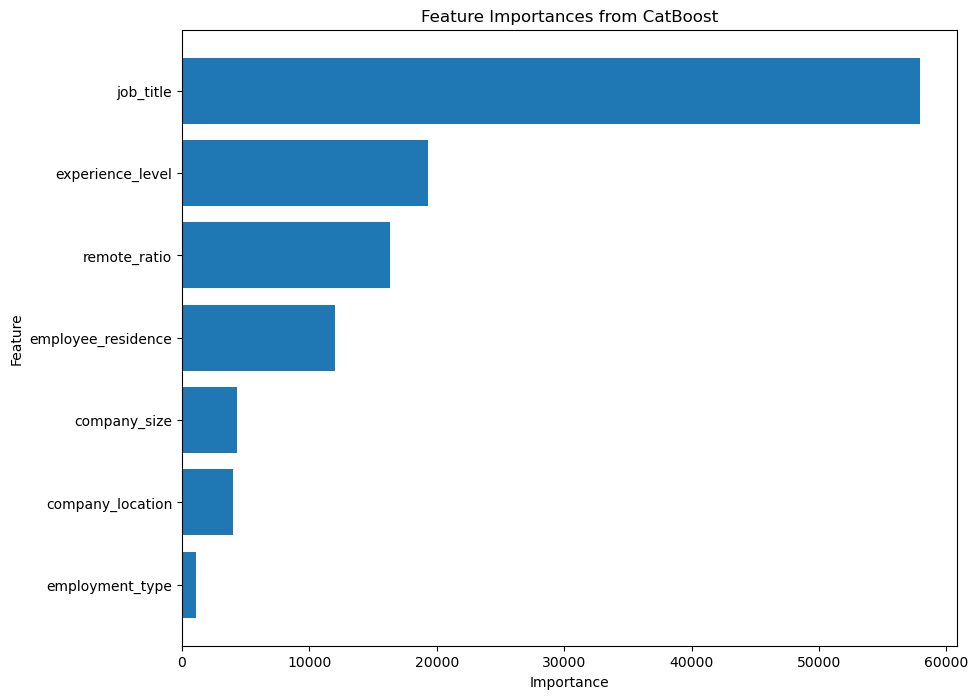

In [88]:
# Feature importances
feature_importances = best_lgbm_model.feature_importances_
feature_names = X_train.columns  # Original feature names

# Combine into a DataFrame 
importances_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances})
importances_df = importances_df.sort_values(by='Importance', ascending=False)

# Plot 
plt.figure(figsize=(10, 8))
plt.barh(importances_df['Feature'], importances_df['Importance'])
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.title("Feature Importances from CatBoost")
plt.gca().invert_yaxis()
plt.show()